# Generieke template inladen RGB Segmentation data

*This notebook is made to run inside Google colab or the [pxl_ML_Docker_v2.0_Tensorflow](https://github.com/PXLAIRobotics/PXL_ML_Docker_v2.0_TensorFlow) container.*

## Installations

### HuggingFace

In [1]:
!pip install datasets
!pip install opendatasets

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python3 -m pip install --upgrade pip
Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python3 -m pip install --upgrade pip


#### Login to HuggingFace by token

In [2]:
from huggingface_hub import notebook_login
notebook_login()

### Kaggle

In [3]:
!pip install kaggle

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python3 -m pip install --upgrade pip


#### Kaggle token
  
Please get your kaggle.json file from kaggle and place it in:
*For container:*  
'notebooks'-folder  
  
*For Google colab:*  
'contents'-folder 

In [4]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

### Roboflow

In [5]:
!pip install roboflow

Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for roboflow from https://files.pythonhosted.org/packages/a5/3e/dd9ba72528559149c0f04e47d30411392e0b9d8a2c8aa9319e65bf21600e/roboflow-1.1.23-py3-none-any.whl.metadata
  Obtaining dependency information for certifi==2023.7.22 from https://files.pythonhosted.org/packages/4c/dd/2234eab22353ffc7d94e8d13177aaa050113286e93e7b40eae01fbf7c3d9/certifi-2023.7.22-py3-none-any.whl.metadata
  Obtaining dependency information for chardet==4.0.0 from https://files.pythonhosted.org/packages/19/c7/fa589626997dd07bd87d9269342ccb74b1720384a4d739a1872bd84fbe68/chardet-4.0.0-py2.py3-none-any.whl.metadata
  Obtaining dependency information for cycler==0.10.0 from https://files.pythonhosted.org/packages/f7/d2/e07d3ebb2bd7af696440ce7e754c59dd546ffe1bbe732c8ab68b9c834e61/cycler-0.10.0-py2.py3-none-any.whl.metadata
  Obtaining dependency information for idna==2.10 from https://files.pythonhosted.org/

## Imports

In [426]:
import pandas as pd
import numpy as np
import io
import os
import json
import glob
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from datasets import load_dataset
from opendatasets import download as load_opendataset
from PIL import Image
from keras.preprocessing.image import ImageDataGenerator
from pathlib import Path
from roboflow import Roboflow
import cv2

## General Class

In [591]:
class Generic_dataset_analysis:
  def __init__(self):  #constructor not used
    raise RuntimeError("Not required to create an instance of this class. This class only has static functions.")
    
  @staticmethod
  def remove_dataset():   #function to remove the datasets folder.
    stream = os.popen('rm -rf ./dataset/')
    stream.close()
  
  @staticmethod
  def _add_single_folders_to_path(path):    #internal function. if a download contains nested single folders, they get added to the path before copy.
    directory = Path(path)
    print(path)
    folder_content = sorted(directory.iterdir())
    while (len(folder_content) == 1):
      path += '/' + folder_content[0].name
      directory = Path(path)
      folder_content = sorted(directory.iterdir())
    return path

  @staticmethod
  def load_segmentation_dataset_from_url(url, label_col_name=None):  #main function. load a dataset by passing the url. Huggingface needs a label columnname to work correctly.
    if not os.path.exists("dataset/"):
      os.makedirs("dataset/")
    elif len(os.listdir("dataset/")) > 0:
      raise RuntimeError("'dataset' folder not empty. Please delete all files first by running the 'remove_dataset()' function of this class.")
    
    split_url = url.split("/")

    if(split_url[2] == "huggingface.co"):
      datasets = load_dataset(split_url[-2] + "/" + split_url[-1])
      dataframes_map = {split: datasets[split].to_pandas() for split in datasets.keys()}

      #print(dataframes_map['train'])

      for key in list(dataframes_map.keys()):
        image_counter = 0
        friendly_key = key
        if(key[0:2] == "te"):
          friendly_key = "test"
        elif(key[0:2] == "tr"):
          friendly_key = "train"
        elif(key[0:2] == "va"):
          friendly_key = "validation"
        #print(dataframes_map[key])
        #print(key)
        test = dataframes_map.get(key)
        keys = test.keys()
        #print(keys)
          
        for folder_name in keys:
          image_counter = 0
          for index, row in dataframes_map.get(key).iterrows():
            if isinstance(row[folder_name], dict):
              #print(row)
              path = "./dataset/{}/{}/".format(friendly_key, folder_name)
              binary_data = row[folder_name].get('bytes', None)
              #print(row['image'])
              if binary_data:
                stream = io.BytesIO(binary_data)
                image = Image.open(stream)
                if not os.path.exists(path):
                  os.makedirs(path)
                image.save("{}/{}.png".format(path, image_counter))
                image_counter += 1
              else:
                image_path = row[folder_name].get('path', None)
                if os.path.exists(image_path):
                  image = Image.open(image_path)
                  if not os.path.exists(path):
                    os.makedirs(path)
                  image.save("{}/{}.png".format(path, image_counter))
                  image_counter += 1
                else:
                  print(f"Image path '{image_path}' does not exist.")
      return dataframes_map
    elif(split_url[2] == "www.kaggle.com"):
      link = " " + split_url[-2] + "/" + split_url[-1]
      unzip = split_url[-1]
                
      load_opendataset(url)
      download_path = Generic_dataset_analysis._add_single_folders_to_path(split_url[-1])
      print(download_path)
      destination_path = "'{}'".format('dataset/')
      download_path = "'{}'".format(download_path)

      stream = os.popen("cp -r {}/* {}".format(download_path, destination_path))
      stream.close()
      
      directory = Path("dataset/")
      for item in directory.iterdir():
        if item.is_dir and item.name[0:2].lower() == "te":
          os.replace("dataset/" + item.name, "dataset/test")
        elif item.is_dir and item.name[0:2].lower() == "tr":
          os.replace("dataset/" + item.name, "dataset/train")
        elif item.is_dir and item.name[0:2].lower() == "va":
          os.replace("dataset/" + item.name, "dataset/validation")
    elif(split_url[2] == "universe.roboflow.com"):
      rf = Roboflow(api_key="ztqwE4dHiRlu1JJrVnLE")
      project = rf.workspace(split_url[3]).project(split_url[4])
      all_versions = project.versions()
      
      latest_version = all_versions[0].version
      dataset = project.version(latest_version).download("yolov5")

      dataset_folder_name = split_url[4] + '-' + latest_version
      destination_path = "'{}'".format('dataset/')

      dataset_folder_name = split_url[4] + '-' + latest_version
      download_dir = Path("./")
      for item in download_dir.iterdir():
        if (item.is_dir and item.name.lower() == dataset_folder_name.lower() and item.name != dataset_folder_name): #check on case differences
          os.replace(item.name, dataset_folder_name)

      split_folder_name = dataset_folder_name.split("-")
      length = len(split_folder_name)

      if length > 2:
        new_name = ''
        for i in range(0, length -2):
          new_name += split_folder_name[i] + '-'
        new_name += split_folder_name[length-1]
        dataset_folder_name = new_name

      stream = os.popen("cp -r {}/* {}".format(dataset_folder_name, destination_path))
      stream.close()

      directory = Path("dataset/")
      for item in directory.iterdir():
        if item.is_dir and item.name[0:2].lower() == "te":
          os.replace("dataset/" + item.name, "dataset/test")
          Generic_dataset_analysis.create_segmented_images('dataset/test/images/', 'dataset/test/labels/')
        elif item.is_dir and item.name[0:2].lower() == "tr":
          os.replace("dataset/" + item.name, "dataset/train")
          Generic_dataset_analysis.create_segmented_images('dataset/train/images/', 'dataset/train/labels/')
        elif item.is_dir and item.name[0:2].lower() == "va":
          os.replace("dataset/" + item.name, "dataset/validation")
          Generic_dataset_analysis.create_segmented_images('dataset/validation/images/', 'dataset/validation/labels/')
          
    else:
      raise RuntimeError("This site is not supported...")
  
  @staticmethod  
  def create_segmented_images(image_folder, label_folder, line_thickness=2):
    image_files = os.listdir(image_folder)

    split_path = image_folder.split('/')
    output_folder = ('/').join(split_path[0:-2]) + '/segmented_images/'
    print(output_folder)
    if not os.path.exists(output_folder):
      os.makedirs(output_folder)

    for image_file in image_files:
        image_path = os.path.join(image_folder, image_file)
        image = cv2.imread(image_path)
        image_shape = image.shape[:2]  

        label_file = image_file.replace(".jpg", ".txt")  
        label_path = os.path.join(label_folder, label_file)

        # If label file exists, create segmented image
        if os.path.exists(label_path):
            with open(label_path, 'r') as file:
                lines = file.readlines()

            segmented_image = np.zeros_like(image)

            for line in lines:
                points = line.split()[1:]
                points = np.array(points, dtype=np.float32).reshape(-1, 2) * np.array(image_shape[::-1])
                points = points.astype(np.int32)
                cv2.fillPoly(segmented_image, [points], color=(0,234,255))

            output_path = os.path.join(output_folder, image_file)
            cv2.imwrite(output_path, segmented_image)

            #print(f"Segmented image saved: {output_path}")
        else:
            print(f"No label file found for {image_file}")


In [575]:
class Image_Display:
    def __init__(self):  #constructor not used
        raise RuntimeError("Not required to create an instance of this class. This class only has static functions.")

    @staticmethod 
    def find_images(folder_path):
        image_paths = []
        
        files_and_folders = os.listdir(folder_path)
        
        for item in files_and_folders:
            item_path = os.path.join(folder_path, item)
            
            if os.path.isfile(item_path):
                if item.endswith('.jpg') or item.endswith('.png') or item.endswith('.jpeg') or item.endswith('.bmp') or item.endswith('.gif'):
                    image_paths.append(item_path)
            elif os.path.isdir(item_path):
                image_paths.extend(Image_Display.find_images(item_path))
        
        return image_paths

    @staticmethod
    def display_random_images(num_images):
        current_dir = os.getcwd()
        dataset_dir = os.path.join(current_dir, 'dataset')
        folders = ['test', 'train', 'validate', 'val']
        
        image_paths = []
        
        for folder in folders:
            folder_path = os.path.join(dataset_dir, folder)
            
            if os.path.exists(folder_path):
                image_paths.extend(Image_Display.find_images(folder_path))
        
        print("Total images found:", len(image_paths))  
        
        if not image_paths:
            print("No images found in the specified directories.")
            return
        
        random_images = random.sample(image_paths, min(num_images, len(image_paths)))
        
        fig = plt.figure(figsize=(15, 15))
        for i, image_path in enumerate(random_images):
            folder_name = image_path.split(os.sep)[-2]
            class_name = image_path.split(os.sep)[-3]
            
            ax = fig.add_subplot((num_images // 3) + 1, 3, i + 1)
            img = mpimg.imread(image_path)
            ax.imshow(img)
            ax.set_title(f'Folder: {class_name}, Subfolder: {folder_name}')
            ax.axis('off')
        plt.show()


    @staticmethod
    def display_random_image_from_path(image_path, num_images):
        image_paths = Image_Display.find_images(image_path)
        random_images = random.sample(image_paths, min(num_images, len(image_paths)))
        
        fig = plt.figure(figsize=(15, 15))
        for i, image_path in enumerate(random_images):
            folder_name = image_path.split(os.sep)[-2]
            class_name = image_path.split(os.sep)[-3]
            
            ax = fig.add_subplot((num_images // 3) + 1, 3, i + 1)
            img = mpimg.imread(image_path)
            ax.imshow(img)
            ax.set_title(f'Folder: {class_name}, Subfolder: {folder_name}')
            ax.axis('off')
        plt.show()


    @staticmethod
    def display_random_image_with_segmented_from_path(image_folder, segmented_folder, num_images_to_display):
        image_files = os.listdir(image_folder)
        segmented_files = os.listdir(segmented_folder)
        
        image_files.sort()
        segmented_files.sort()

        shuffled_indices = list(range(len(image_files)))
        random.shuffle(shuffled_indices)
        
        random_images = shuffled_indices[:num_images_to_display]
        
        for idx in random_images:
            image_path = os.path.join(image_folder, image_files[idx])
            segmented_path = os.path.join(segmented_folder, segmented_files[idx])
            
            image = mpimg.imread(image_path)
            segmented_image = mpimg.imread(segmented_path)
            
            # Display original image
            plt.figure(figsize=(10,5))
            plt.subplot(1, 2, 1)
            plt.imshow(image)
            plt.title('Original Image ' + image_files[idx])
            plt.axis('off')
            
            # Display segmented image
            plt.subplot(1, 2, 2)
            plt.imshow(segmented_image)
            plt.title('Segmented Image '+ segmented_files[idx])
            plt.axis('off')
            
            plt.show()





#### Huggingface

##### Test 1

In [402]:
Generic_dataset_analysis.remove_dataset()

In [403]:
Generic_dataset_analysis.load_segmentation_dataset_from_url("https://huggingface.co/datasets/TrainingDataPro/plantations_segmentation")

{'train':     image_id                                              image  \
 0          1  {'bytes': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHD...   
 1          2  {'bytes': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x...   
 2          3  {'bytes': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x...   
 3          4  {'bytes': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x...   
 4          5  {'bytes': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHD...   
 5          6  {'bytes': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHD...   
 6          7  {'bytes': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHD...   
 7          8  {'bytes': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHD...   
 8          9  {'bytes': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x...   
 9         10  {'bytes': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x...   
 10        11  {'bytes': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHD...   
 11        12  {'bytes': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHD...   
 12        13  {'bytes': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x...   
 
                                    c

Total images found: 39


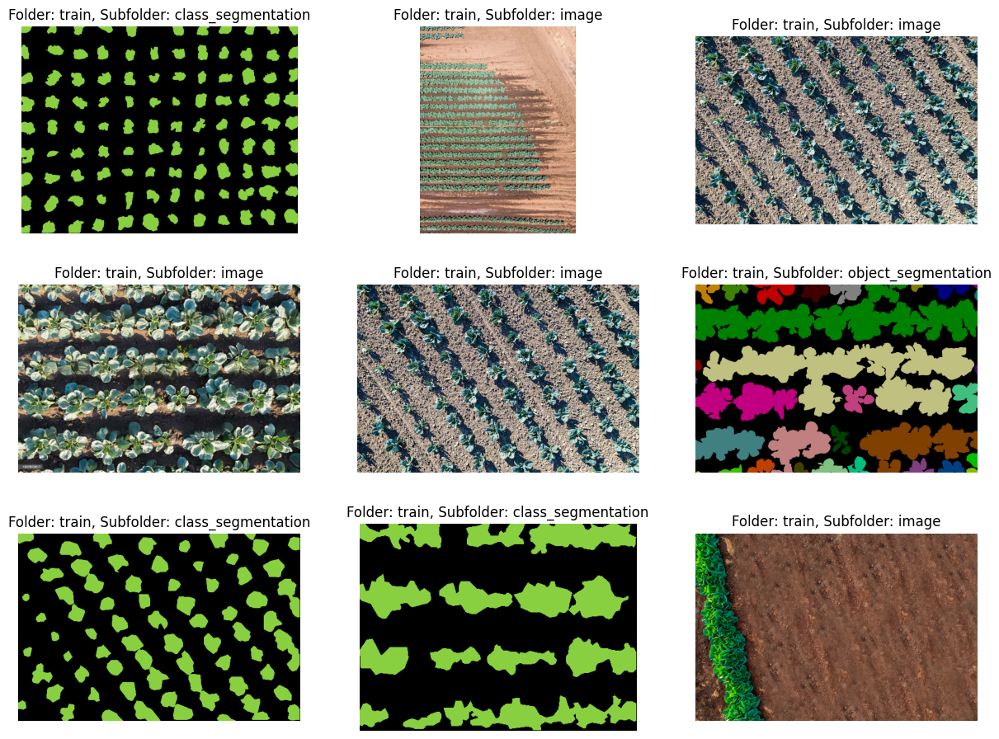

In [179]:
Image_Display.display_random_images(9)

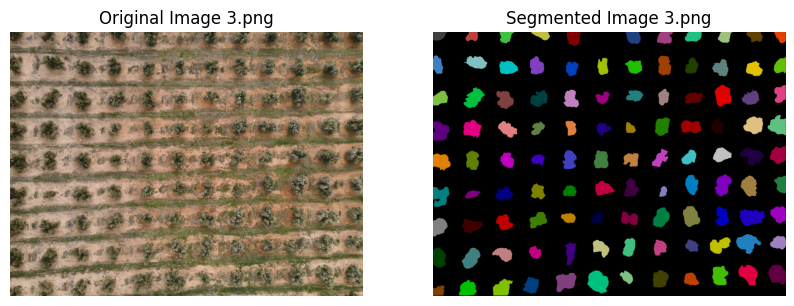

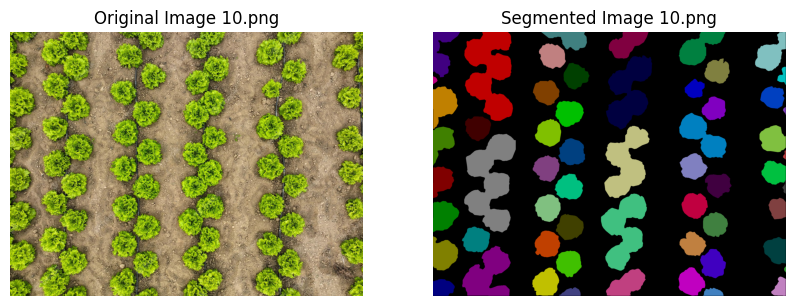

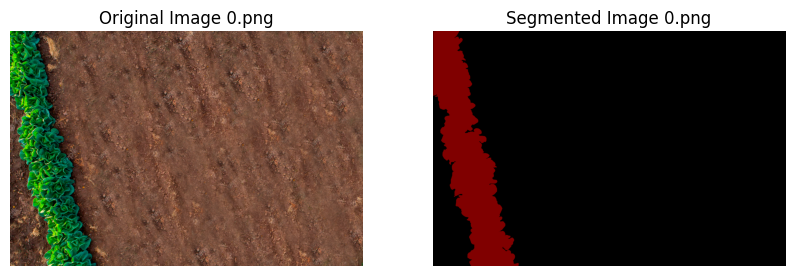

In [180]:
Image_Display.display_random_image_with_segmented_from_path('dataset/train/image/','dataset/train/object_segmentation/', 3)

##### Test 2

In [181]:
Generic_dataset_analysis.remove_dataset()

In [182]:
df = Generic_dataset_analysis.load_segmentation_dataset_from_url('https://huggingface.co/datasets/lisawen/soybean_dataset')

Total images found: 1360


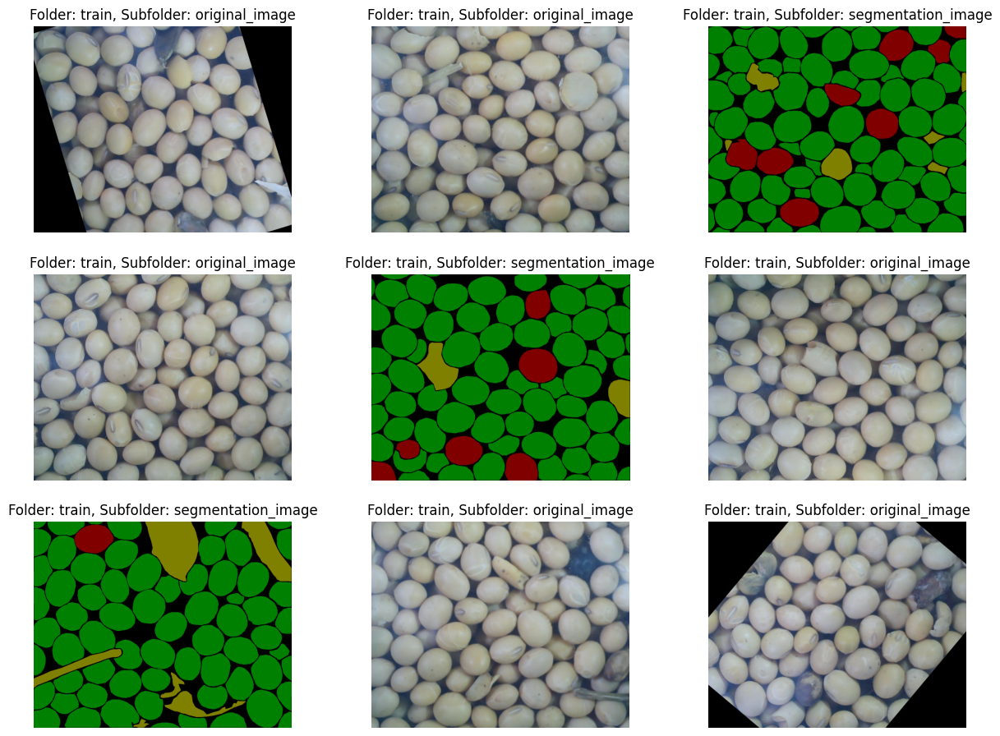

In [184]:
Image_Display.display_random_images(9)

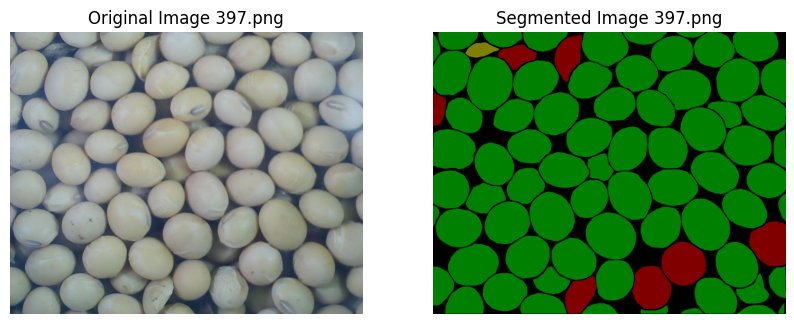

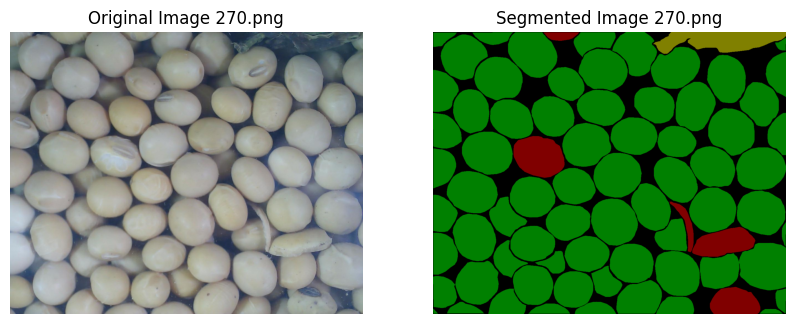

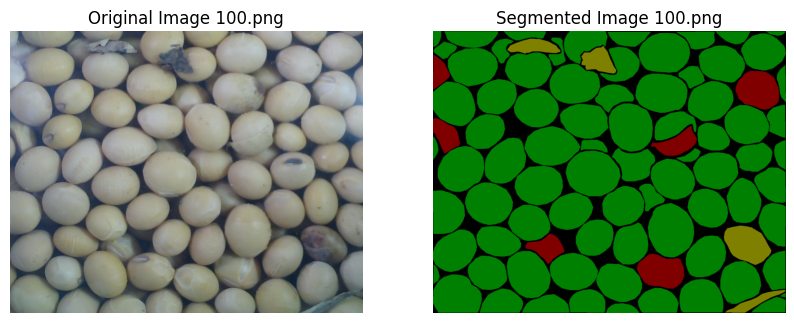

In [185]:
Image_Display.display_random_image_with_segmented_from_path('dataset/train/original_image/','dataset/train/segmentation_image/', 3)

##### Test 3

In [404]:
Generic_dataset_analysis.remove_dataset()

In [405]:
Generic_dataset_analysis.load_segmentation_dataset_from_url('https://www.kaggle.com/datasets/erickendric/tree-dataset-of-urban-street-segmentation-tree')

Skipping, found downloaded files in "./tree-dataset-of-urban-street-segmentation-tree" (use force=True to force download)
tree-dataset-of-urban-street-segmentation-tree
tree-dataset-of-urban-street-segmentation-tree/tree/VOCdevkit/VOC2012


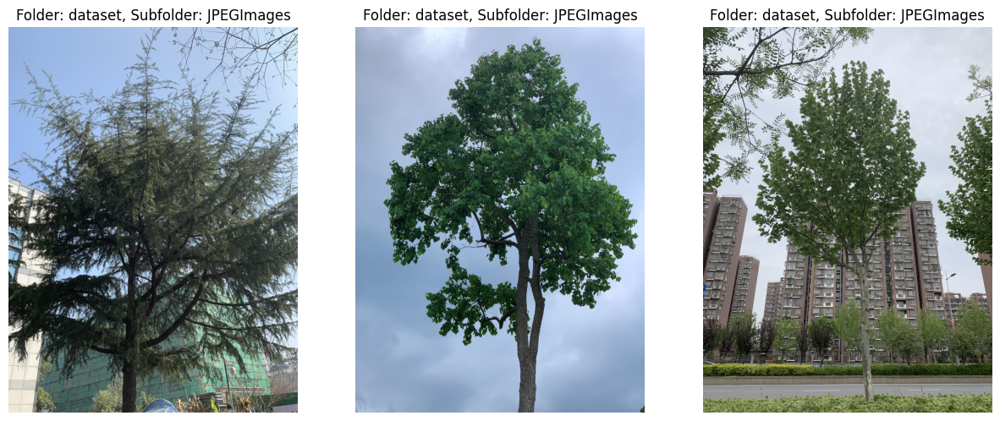

In [406]:
Image_Display.display_random_image_from_path('./dataset/JPEGImages/',3)

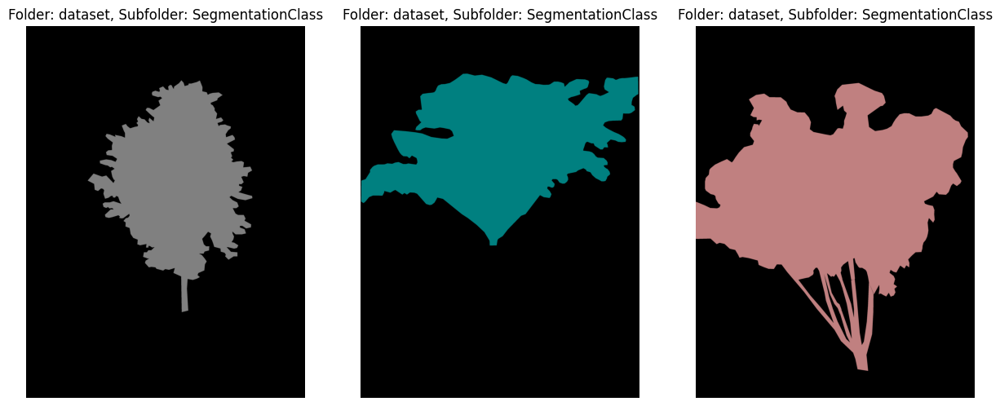

In [189]:
Image_Display.display_random_image_from_path('./dataset/SegmentationClass/',3)

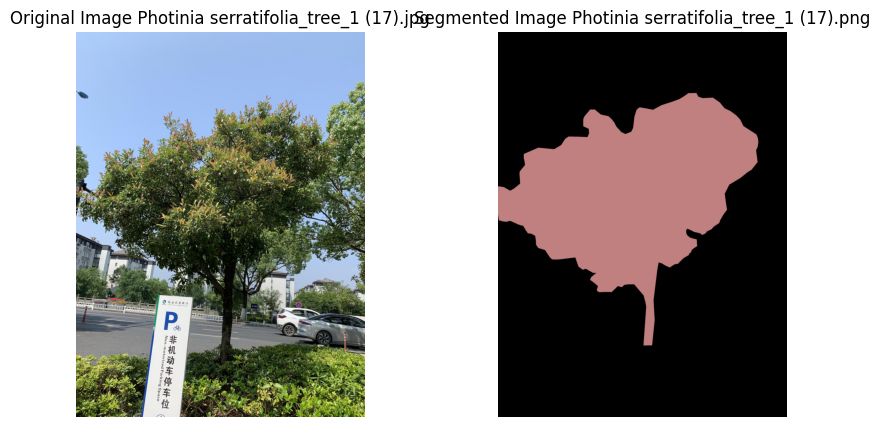

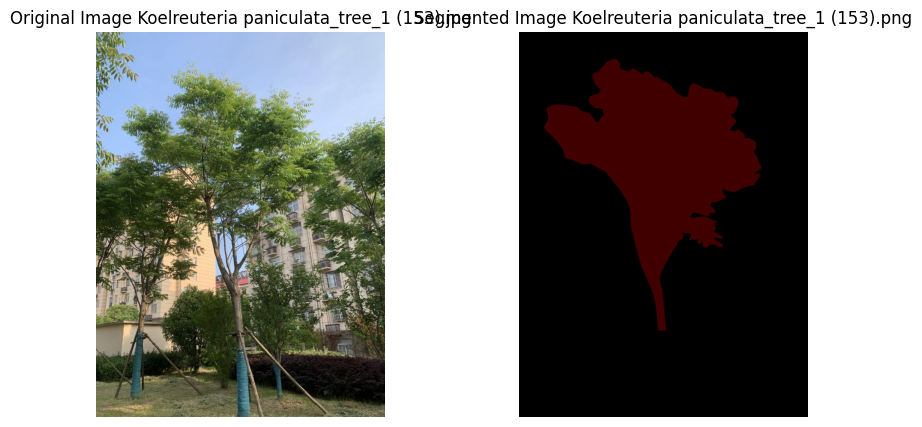

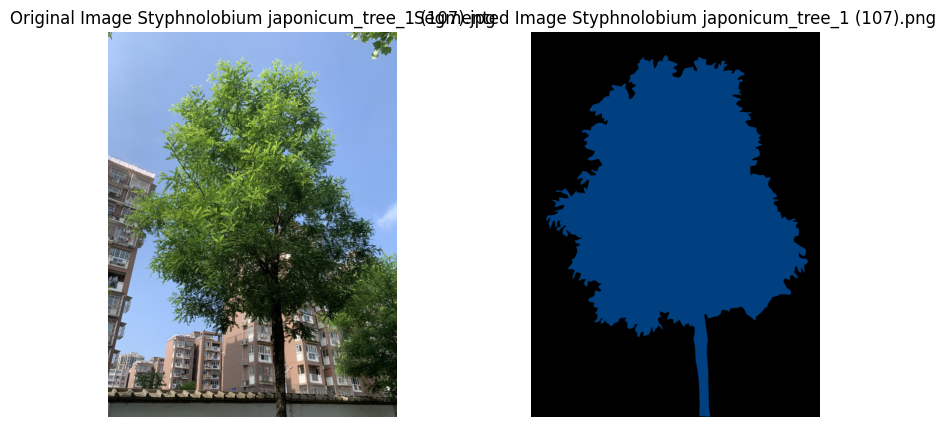

In [190]:
Image_Display.display_random_image_with_segmented_from_path('dataset/JPEGImages/','dataset/SegmentationClass/', 3)

#### Kaggle

##### Test 1

In [191]:
Generic_dataset_analysis.remove_dataset()

In [192]:
Generic_dataset_analysis.load_segmentation_dataset_from_url('https://www.kaggle.com/datasets/santhoshkumarv/dog-segmentation-dataset')

Skipping, found downloaded files in "./dog-segmentation-dataset" (use force=True to force download)
dog-segmentation-dataset
dog-segmentation-dataset/Dog Segmentation


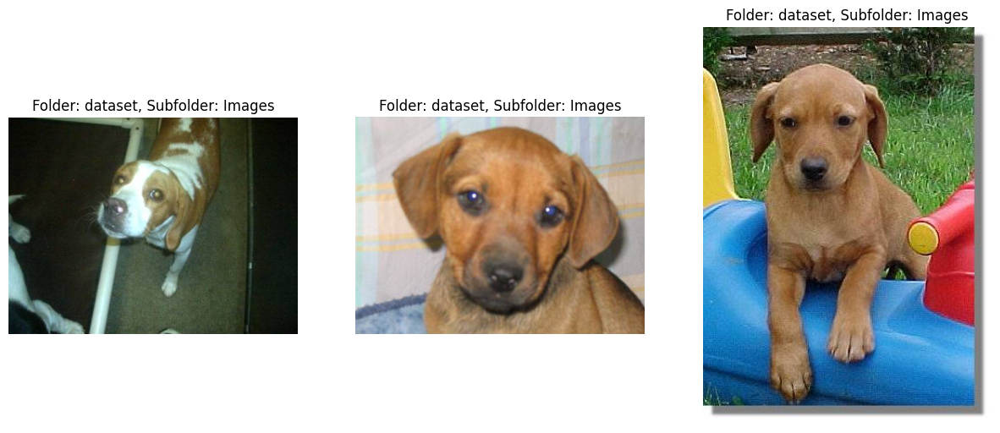

In [193]:
Image_Display.display_random_image_from_path('./dataset/Images',3)

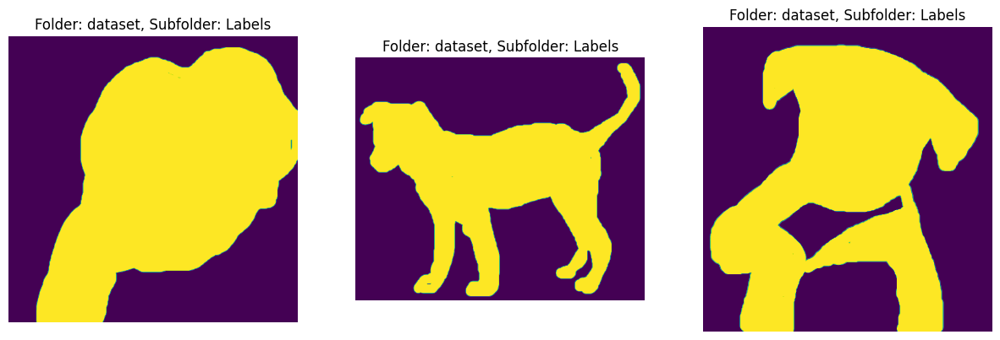

In [194]:
Image_Display.display_random_image_from_path('./dataset/Labels',3)

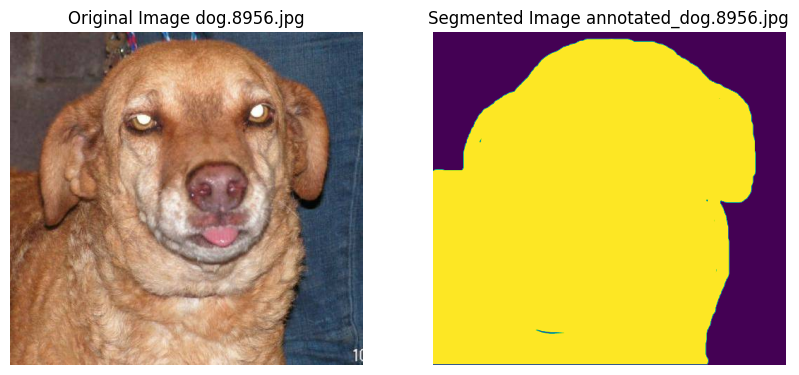

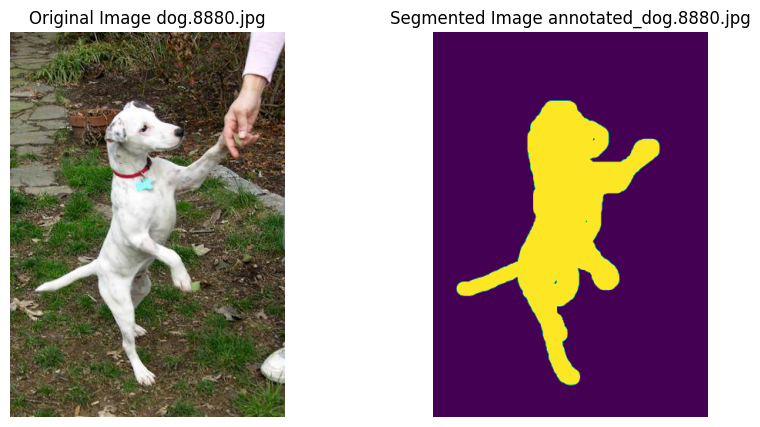

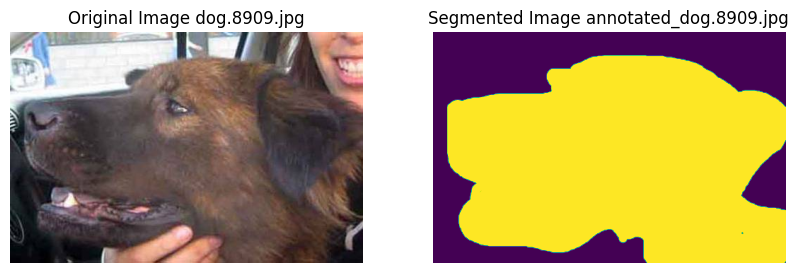

In [196]:
Image_Display.display_random_image_with_segmented_from_path('dataset/Images/','dataset/Labels/', 3)

##### Test 2

In [197]:
Generic_dataset_analysis.remove_dataset()

In [198]:
Generic_dataset_analysis.load_segmentation_dataset_from_url('https://www.kaggle.com/datasets/quadeer15sh/augmented-forest-segmentation')

Skipping, found downloaded files in "./augmented-forest-segmentation" (use force=True to force download)
augmented-forest-segmentation
augmented-forest-segmentation


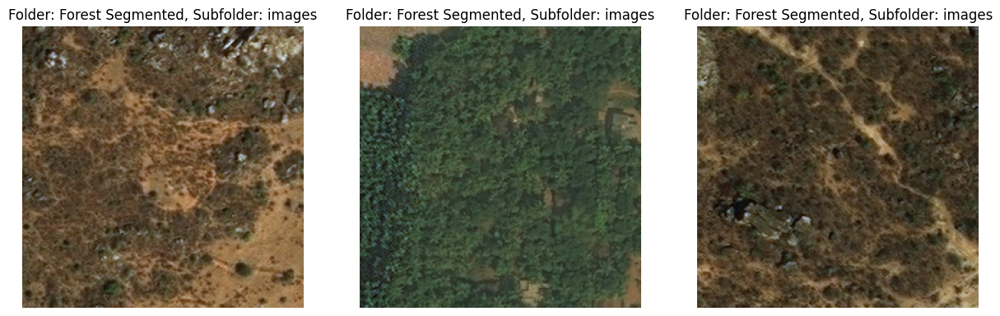

In [201]:
Image_Display.display_random_image_from_path('dataset/Forest Segmented/Forest Segmented/images',3)

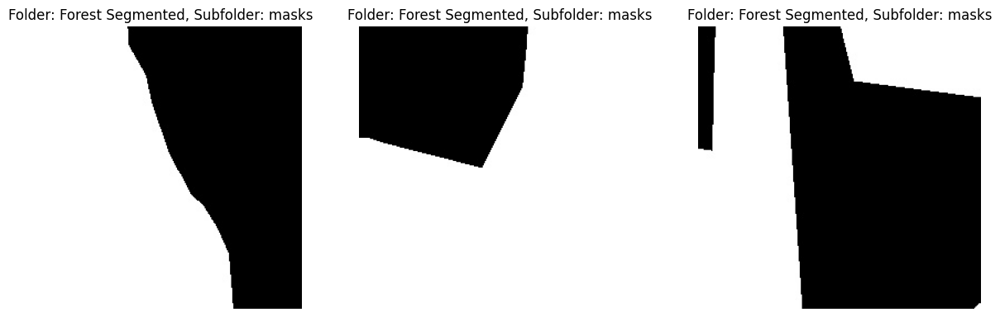

In [202]:
Image_Display.display_random_image_from_path('dataset/Forest Segmented/Forest Segmented/masks',3)

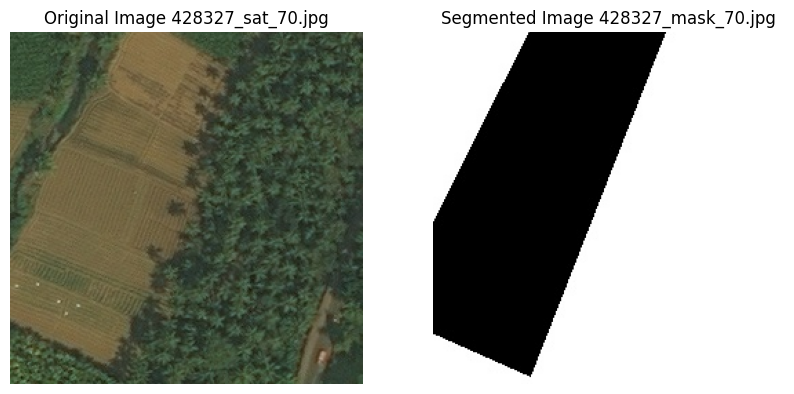

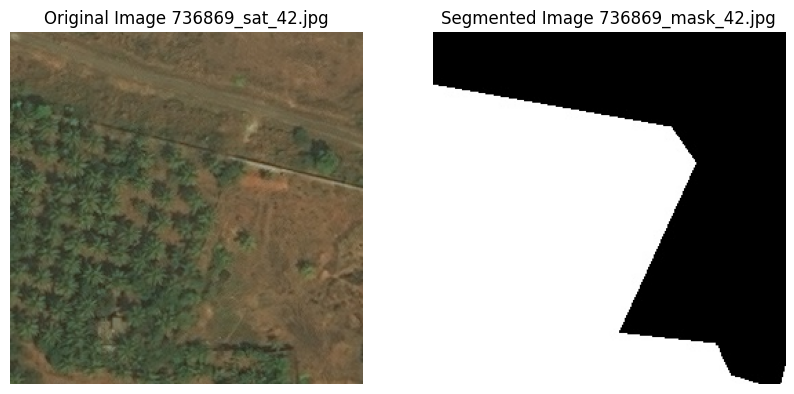

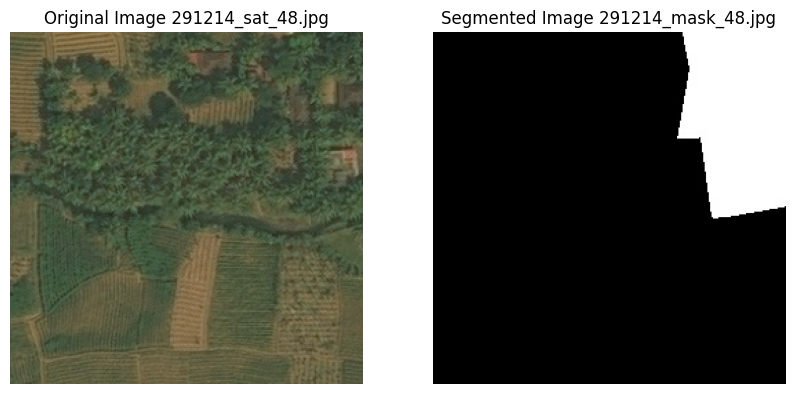

In [200]:
Image_Display.display_random_image_with_segmented_from_path('dataset/Forest Segmented/Forest Segmented/images','dataset/Forest Segmented/Forest Segmented/masks', 3)

##### Test 3

In [203]:
Generic_dataset_analysis.remove_dataset()

In [204]:
Generic_dataset_analysis.load_segmentation_dataset_from_url('https://www.kaggle.com/datasets/ashish2001/semantic-segmentation-of-underwater-imagery-suim')

Skipping, found downloaded files in "./semantic-segmentation-of-underwater-imagery-suim" (use force=True to force download)
semantic-segmentation-of-underwater-imagery-suim
semantic-segmentation-of-underwater-imagery-suim


Total images found: 4150


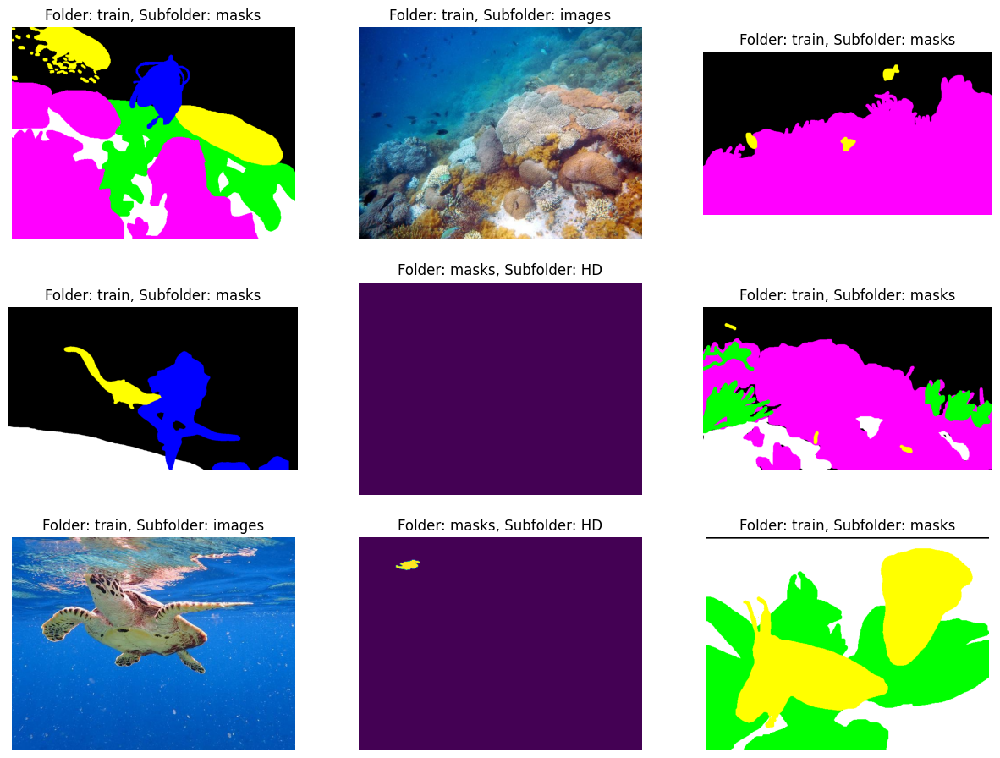

In [205]:
Image_Display.display_random_images(9)

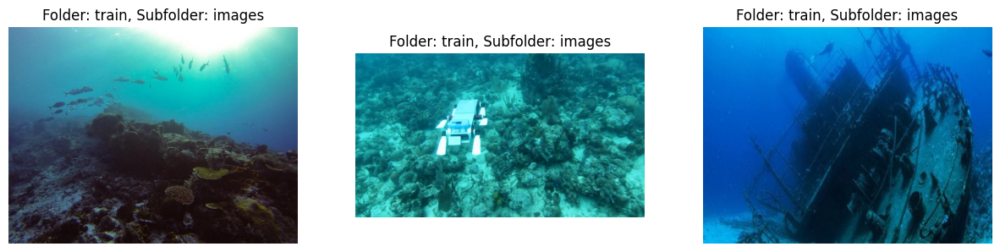

In [206]:
Image_Display.display_random_image_from_path('dataset/train/images', 3)

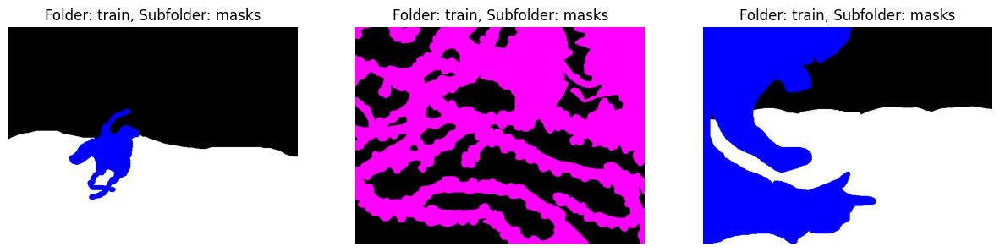

In [207]:
Image_Display.display_random_image_from_path('dataset/train/masks', 3)

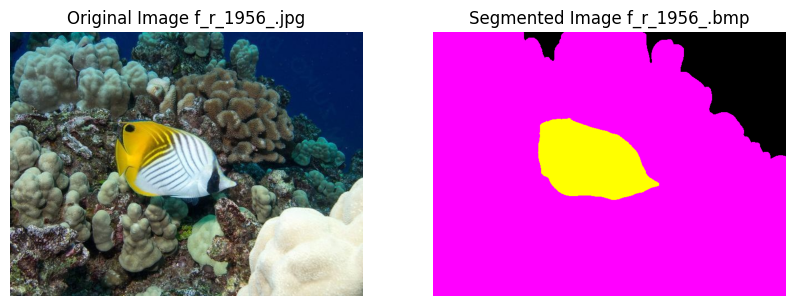

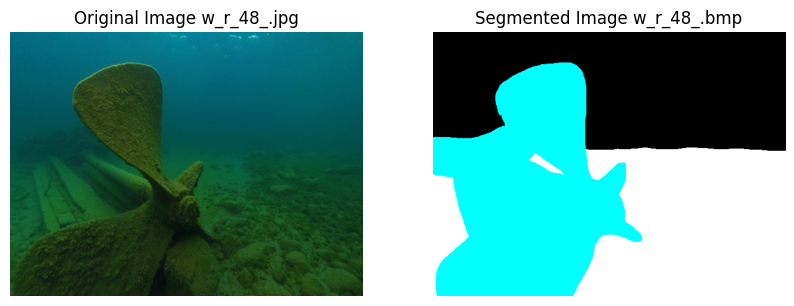

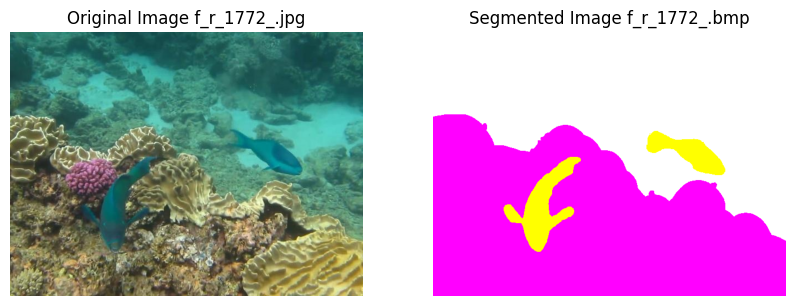

In [209]:
Image_Display.display_random_image_with_segmented_from_path('dataset/train/images', 'dataset/train/masks', 3)


#### Roboflow

##### Test 1

In [594]:
Generic_dataset_analysis.remove_dataset()

In [595]:
Generic_dataset_analysis.load_segmentation_dataset_from_url('https://universe.roboflow.com/earthworm/earthworm-0kxk9')

loading Roboflow workspace...
loading Roboflow project...
dataset/test/segmented_images/
dataset/validation/segmented_images/
dataset/train/segmented_images/


Total images found: 1030


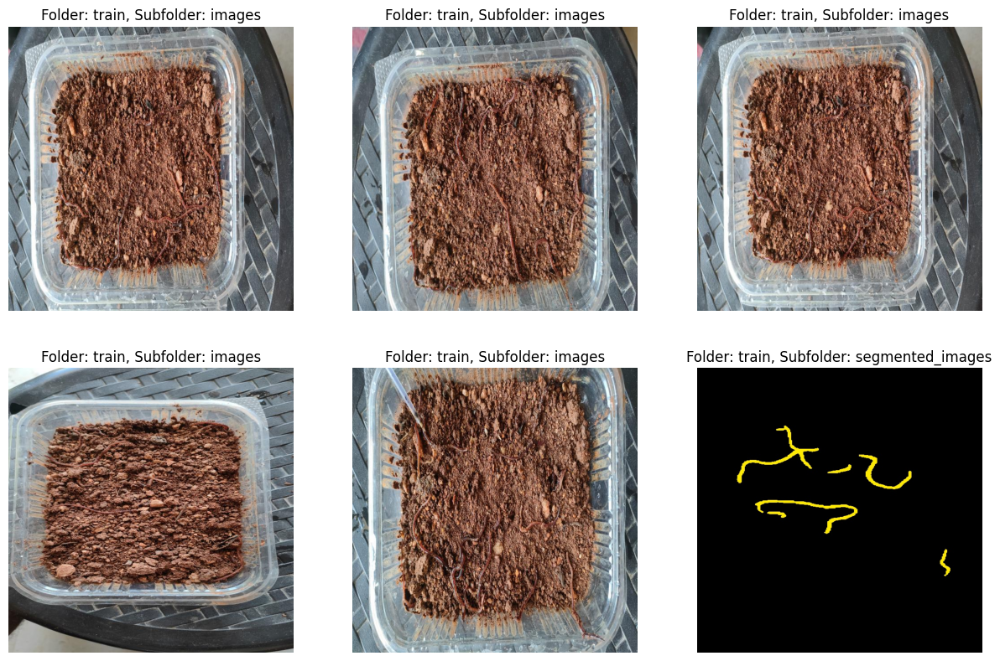

In [596]:
Image_Display.display_random_images(6)

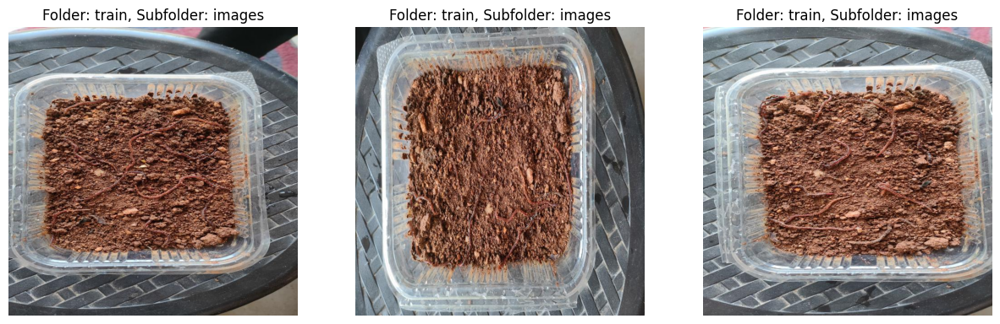

In [597]:
Image_Display.display_random_image_from_path('dataset/train/images', 3)

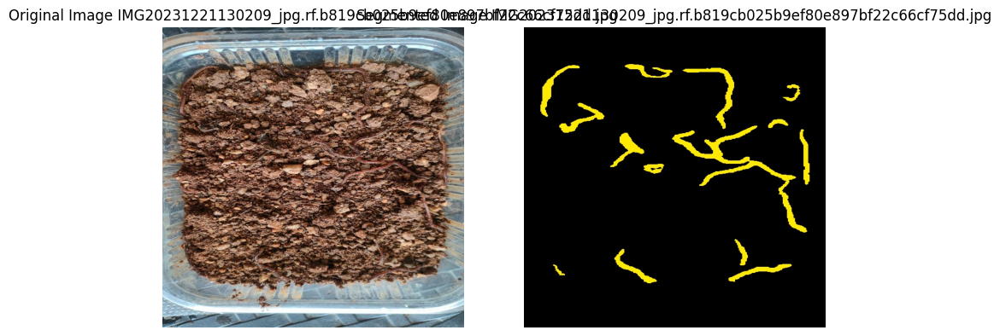

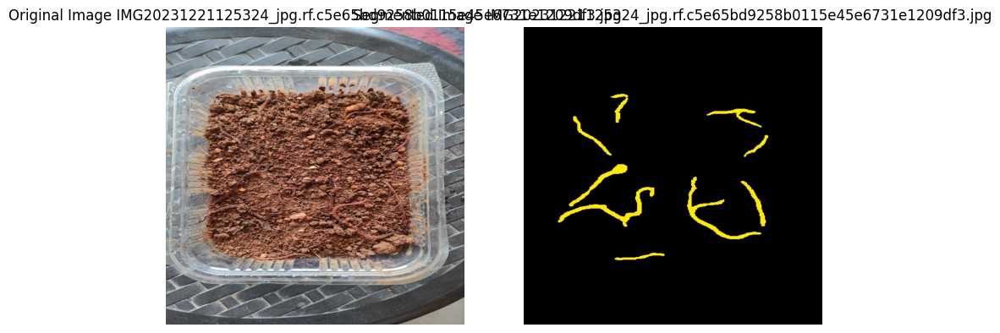

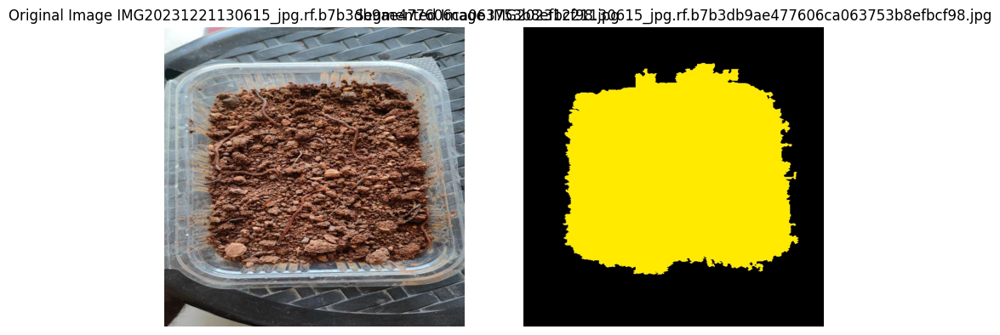

In [598]:
Image_Display.display_random_image_with_segmented_from_path('dataset/train/images', 'dataset/train/segmented_images', 3)

##### Test 2 

In [612]:
Generic_dataset_analysis.remove_dataset()

In [613]:
Generic_dataset_analysis.load_segmentation_dataset_from_url('https://universe.roboflow.com/hieunguyen/classroomsegmentation')

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to ClassroomSegmentation-2 in yolov5pytorch:: 100%|█| 1136/1136 [00:00<00:00, 29552.74it/s


dataset/train/segmented_images/


Total images found: 1130


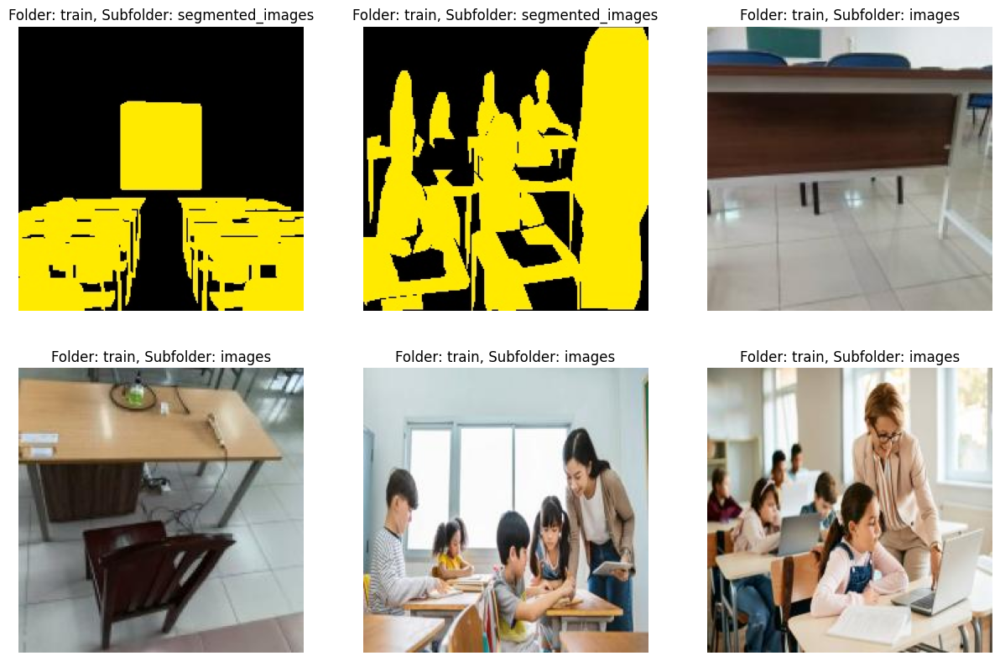

In [614]:
Image_Display.display_random_images(6)

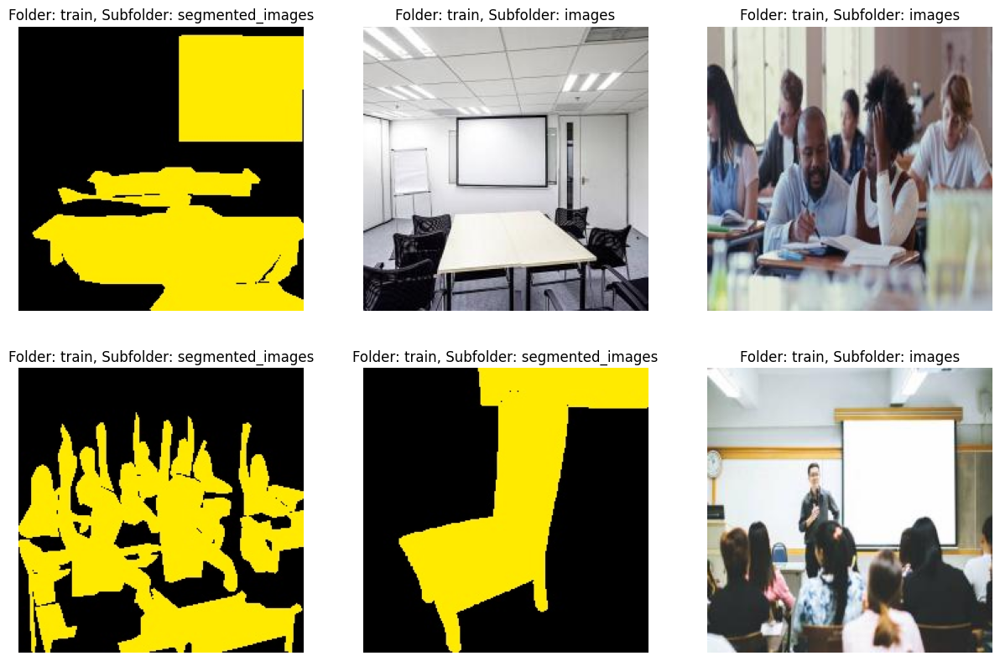

In [615]:
Image_Display.display_random_image_from_path('./dataset/train',6)

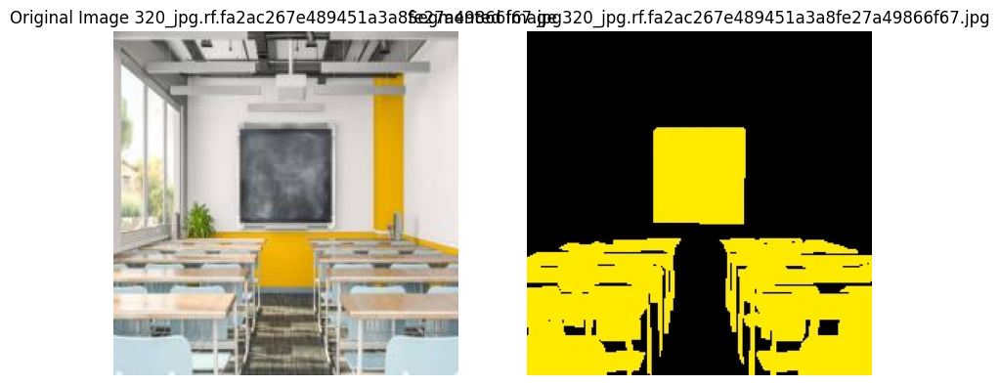

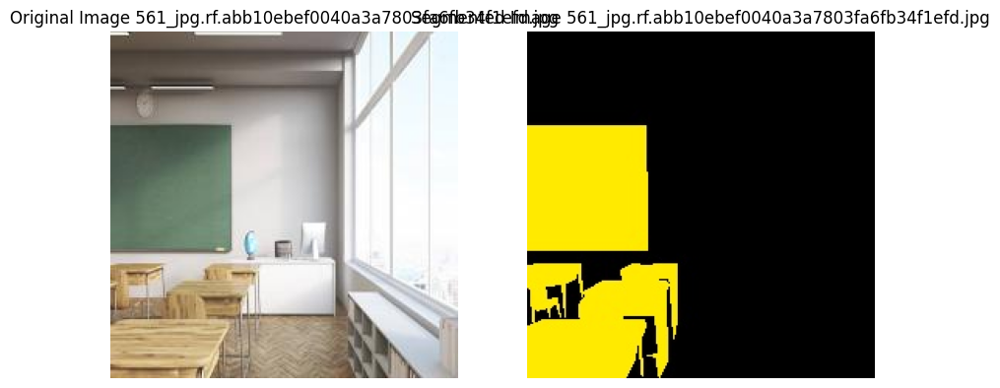

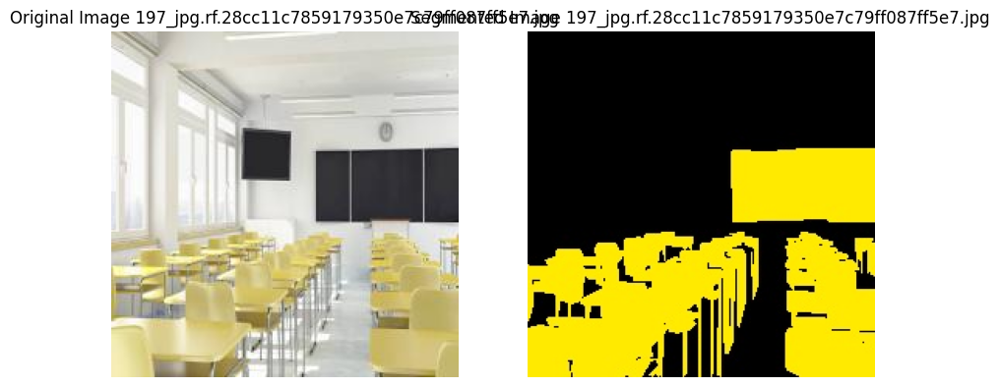

In [616]:
Image_Display.display_random_image_with_segmented_from_path('dataset/train/images', 'dataset/train/segmented_images', 3)

##### Test 3

In [606]:
Generic_dataset_analysis.remove_dataset()

In [607]:
Generic_dataset_analysis.load_segmentation_dataset_from_url('https://universe.roboflow.com/education-qmqst/object-detection-wzzx6')

loading Roboflow workspace...
loading Roboflow project...
dataset/test/segmented_images/
dataset/validation/segmented_images/
dataset/train/segmented_images/


Total images found: 9972


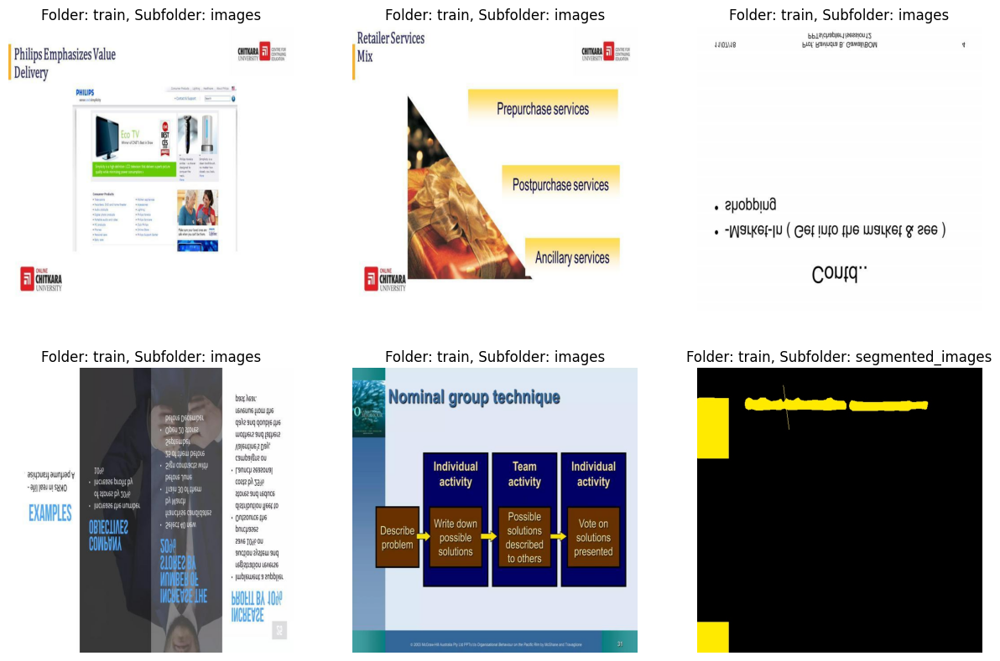

In [608]:
Image_Display.display_random_images(6)

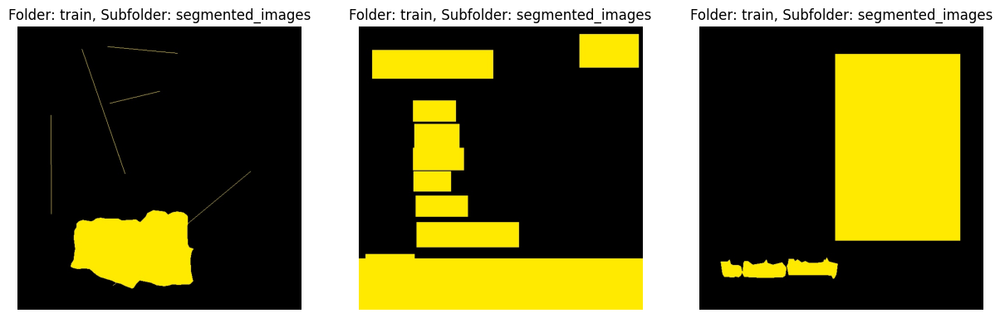

In [609]:
Image_Display.display_random_image_from_path('./dataset/train',3)

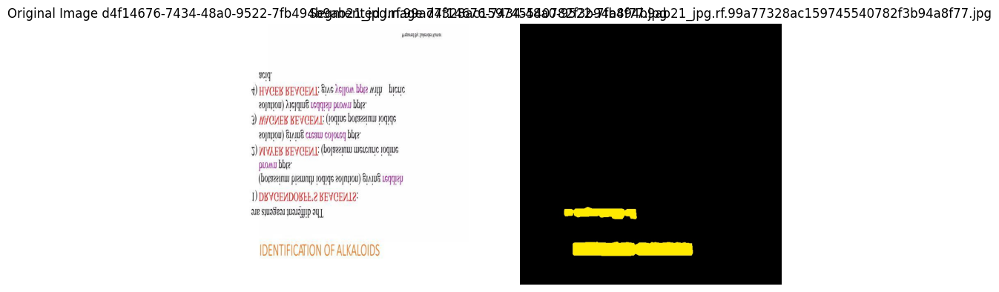

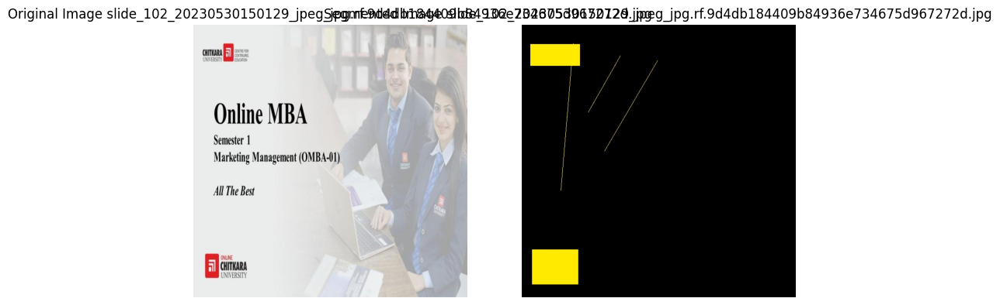

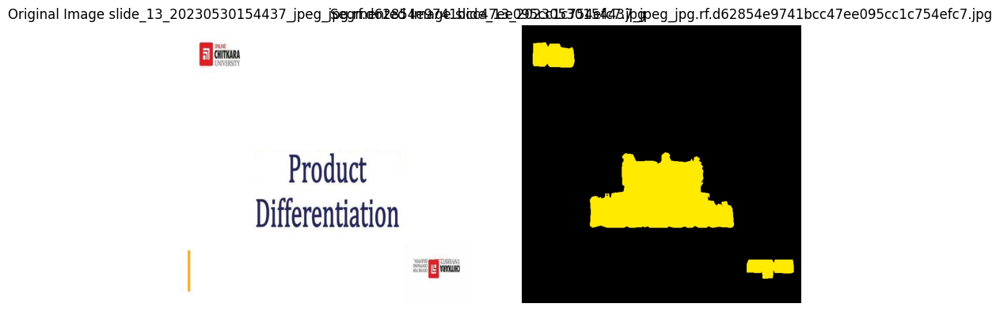

In [610]:
Image_Display.display_random_image_with_segmented_from_path('dataset/train/images', 'dataset/train/segmented_images', 3)